In [1]:
import matplotlib.pyplot as plt
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import load_img
from tensorflow.keras.preprocessing.image import img_to_array

import glob
import imageio
import os
import PIL
import time

from IPython import display

In [2]:
# Set all the constants
IMG_HEIGHT = 48
IMG_WIDTH = 48
IMG_CHANNELS = 3
IMG_SHAPE = (IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS)

BATCH_SIZE = 256
NUM_OF_EPOCHS = 1000
NOISE_VECTOR_LENGTH = 200
NUM_OF_EXAMPLES_TO_GENERATE = 3

DATASET_DIR = 'kaggle_celeba_dataset/img_align_celeba/img_align_celeba/'

In [3]:
# Load dataset. Use all the images to train for now.

all_img_names = os.listdir(DATASET_DIR)
np.random.shuffle(all_img_names)
N_total = len(all_img_names)

# N_train = 200000
N_train = N_total
train_img_names = all_img_names[ : N_train]

# N_test = N_total - N_train
# test_img_names  = all_img_names[N_train : (N_train + N_test)]

print('Total images in dataset: ' + str(N_total))
print('Train images: ' + str(N_train))

# print('Test images: ' + str(N_test))
# print('Train/Test split: ' + str((N_train/N_total) * 100) + ' %')

Total images in dataset: 202599
Train images: 202599


In [4]:
# Converts RGB images to numpy
def get_np_data_for_dataset(image_names):
    data_set = []

    for i, filename in enumerate(image_names):
        image = load_img(DATASET_DIR + "/" + filename, target_size = (IMG_HEIGHT, IMG_WIDTH))
        image = (img_to_array(image) - 127.5) / 127.5
        data_set.append(image)

    data_set = np.array(data_set)
    return(data_set)

In [5]:
train_images = get_np_data_for_dataset(train_img_names)
print("train_images shape: {}".format(train_images.shape))

# test_images  = get_np_data_for_dataset(test_img_names)
# print("test_images shape: {}".format(test_images.shape))

train_images shape: (202599, 48, 48, 3)


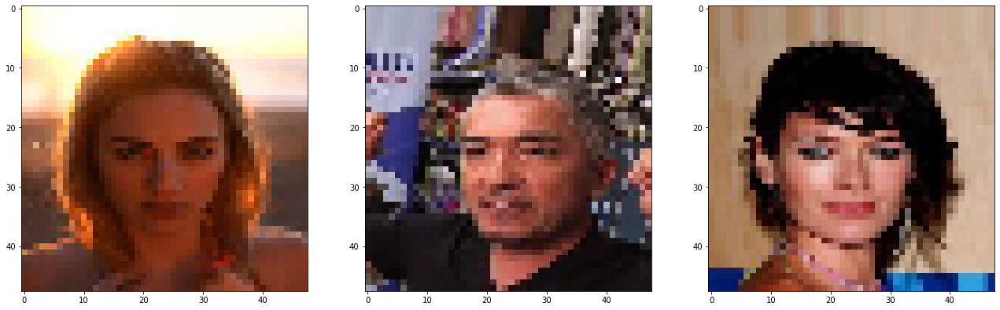

In [6]:
# Show some sample images from training set
fig = plt.figure(figsize=(30, 10))
for i in range(1, 4):
    ax = fig.add_subplot(1, 4, i)
    ax.imshow((train_images[i] * 127.5 + 127.5).astype(int))
plt.show()

In [7]:
# Create tensors from dataset
X_train = tf.data.Dataset.from_tensor_slices(train_images).shuffle(10000).batch(BATCH_SIZE)
# X_test = tf.data.Dataset.from_tensor_slices(train_images).shuffle(1000).batch(BATCH_SIZE)

In [8]:
# The generator network
def build_generator():
    model = tf.keras.Sequential()

    model.add(layers.Dense(
        int(IMG_HEIGHT / 8) * int(IMG_WIDTH / 8) * 256,
        use_bias=False,
        input_shape=(NOISE_VECTOR_LENGTH, )
    ))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    model.add(layers.Reshape((int(IMG_HEIGHT / 8), int(IMG_WIDTH / 8), 256)))

    model.add(layers.Conv2DTranspose(128, (5, 5), strides=(1, 1), padding='same', use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    model.add(layers.Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same', use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    model.add(layers.Conv2DTranspose(32, (5, 5), strides=(2, 2), padding='same', use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    model.add(layers.Conv2DTranspose(3, (5, 5), strides=(2, 2), padding='same', use_bias=False, activation='tanh'))

    return model

In [9]:
# The discriminator network
def build_discriminator():
    model = tf.keras.Sequential()

    model.add(layers.Conv2D(32, (5, 5), strides=(2, 2), padding='same', input_shape=IMG_SHAPE))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))

    model.add(layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same', input_shape=IMG_SHAPE))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))

    model.add(layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))

    model.add(layers.Flatten())
    model.add(layers.Dense(1))

    return model

In [10]:
# Setup optimizers for both networks
generator_optimizer = Adam(1e-4)
discriminator_optimizer = Adam(2e-4)
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [11]:
def get_discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

In [12]:
def get_generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

In [13]:
# Util method to predict from generator and save the predicted image
def generate_and_save_images(model, epoch, test_input):
    predictions = model(test_input, training=False)

    fig = plt.figure(figsize=(30, 10))
    for i in range(predictions.shape[0]):
        plt.subplot(1, 4, i+1)
        plt.imshow((predictions[i] * 127.5 + 127.5).numpy().astype(int))
        plt.axis('off')

    plt.savefig('image_at_epoch_{:04d}.png'.format(epoch))
    plt.show()

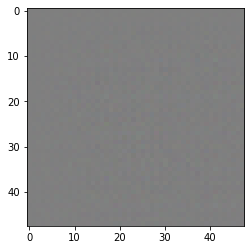

In [14]:
generator_model = build_generator()

seed_noise = tf.random.normal([NUM_OF_EXAMPLES_TO_GENERATE, NOISE_VECTOR_LENGTH])
generated_image = generator_model(seed_noise, training=False)

plt.imshow((generated_image[0] * 127.5 + 127.5).numpy().astype(int))

In [15]:
discriminator_model = build_discriminator()
decision = discriminator_model(generated_image, training=False)

print(decision[0])

tf.Tensor([4.3962733e-05], shape=(1,), dtype=float32)


In [16]:
# One training step: forward and back-prop
@tf.function
def train_step(images):
    noise = tf.random.normal([BATCH_SIZE, NOISE_VECTOR_LENGTH])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_images = generator_model(noise, training=True)
        
        # Add some noise to prevent discriminator from overfitting
        real_output_decision = discriminator_model(
            images + tf.random.normal(shape=tf.shape(images), mean=0.0, stddev=0.1, dtype=tf.float32),
            training=True
        )
        fake_output_decision = discriminator_model(
            generated_images + tf.random.normal(shape=tf.shape(generated_images), mean=0.0, stddev=0.1, dtype=tf.float32),
            training=True
        )

        gen_loss = get_generator_loss(fake_output_decision)
        disc_loss = get_discriminator_loss(real_output_decision, fake_output_decision)

    gradients_of_generator = gen_tape.gradient(gen_loss, generator_model.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator_model.trainable_variables)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator_model.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator_model.trainable_variables))
    
    return (gen_loss, disc_loss)

In [17]:
gen_losses = []
disc_losses = []

# Training loop
def train(dataset, epochs):
    total_training_time = 0
    for epoch in range(0, epochs):
        start = time.time()
        
        gen_losses_for_batches = []
        disc_losses_for_batches = []

        for image_batch in dataset:
            gen_loss, disc_loss = train_step(image_batch)
            gen_losses_for_batches.append(gen_loss)
            disc_losses_for_batches.append(disc_loss)
            
        avg_gen_loss = np.mean(gen_losses_for_batches)
        avg_disc_loss = np.mean(disc_losses_for_batches)
        
        gen_losses.append(avg_gen_loss)
        disc_losses.append(avg_disc_loss)
        
        # Produce images for the GIF as we train
        display.clear_output(wait=True)
        generate_and_save_images(generator_model, epoch + 1, seed_noise)
        
        # Plot losses through epochs
        plt.plot(gen_losses, 'r',
                 disc_losses, 'b')
        plt.legend(['Gen_loss', 'Disc_loss'])
        plt.show()

        epoch_time = time.time() - start
        total_training_time += epoch_time
        avg_epoch_time = total_training_time / (epoch + 1)
        training_eta = avg_epoch_time * (epochs - epoch) / 3600.0
        print ('Time for epoch {} is {} sec'.format(epoch + 1, epoch_time))
        print ('Generator loss for epoch {} is {}'.format(epoch + 1, avg_gen_loss))
        print ('Discriminator loss for epoch {} is {}'.format(epoch + 1, avg_disc_loss))
        print ('Current average epoch time is {} sec'.format(avg_epoch_time))
        if training_eta >= 1:
            print ('Training ETA is {} hr'.format(training_eta))
        elif training_eta * 60.0 >= 1:
            print ('Training ETA is {} min'.format(training_eta * 60.0))
        else:
            print ('Training ETA is {} sec'.format(training_eta * 3600.0))

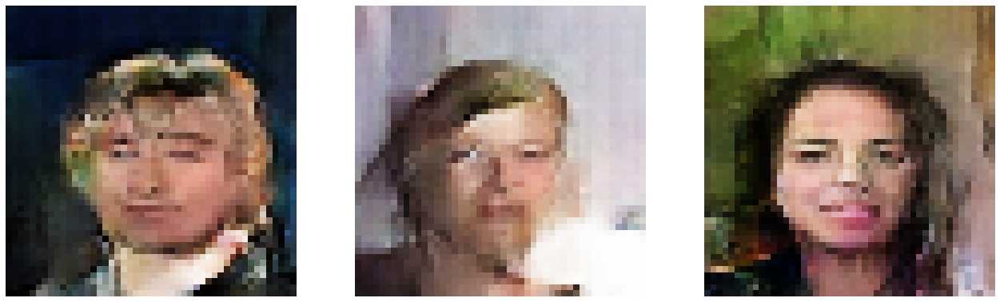

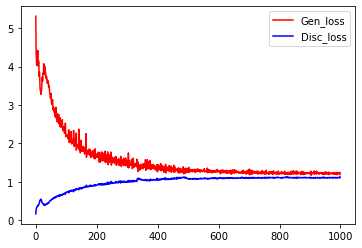

Time for epoch 1000 is 51.29675054550171 sec
Generator loss for epoch 1000 is 1.2241389751434326
Discriminator loss for epoch 1000 is 1.108196496963501
Current average epoch time is 51.31846468257904 sec
Training ETA is 51.31846468257904 sec


In [18]:
train(X_train, NUM_OF_EPOCHS)

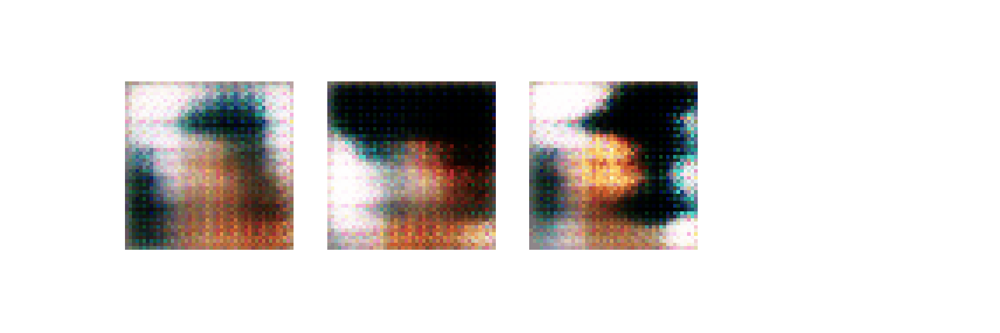

In [20]:
# Create GIF from all the generated images through training process

anim_file = 'celeba_gan.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
    filenames = glob.glob('image*.png')
    filenames = sorted(filenames)
    last = -1

    for i, filename in enumerate(filenames):
        frame = 2 * (i ** 0.5)
        if round(frame) > round(last):
          last = frame
        else:
          continue
        image = imageio.imread(filename)
        writer.append_data(image)

    image = imageio.imread(filename)
    writer.append_data(image)

display.Image(filename=anim_file)

In [21]:
# Save entire models
generator_model.save('generator_model.h5')
discriminator_model.save('discriminator_model.h5')

In [22]:
# Synthesize new images using the trained generator
N_ROWS = 32
N_COLS = 32
NUM_OF_SYNTHESIZED_IMAGES = N_ROWS * N_COLS

synthesized_images = generator_model(
    tf.random.normal([NUM_OF_SYNTHESIZED_IMAGES, NOISE_VECTOR_LENGTH]),
    training=False
)

fig = plt.figure(figsize=(16, 16), dpi=720)
for i in range(NUM_OF_SYNTHESIZED_IMAGES):
    plt.subplot(N_ROWS, N_COLS, i + 1)
    plt.imshow((synthesized_images[i] * 127.5 + 127.5).numpy().astype(int))
    plt.axis('off')

plt.savefig('synthesized_images.png')
plt.show()

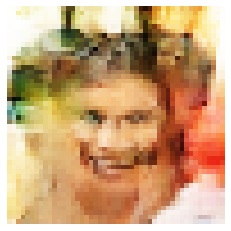

Feature index: 199


In [23]:
# Interpolate through the input distribution and visualize it's effect on generated images
NUM_STEPS = 100

z = tf.random.normal([1, NOISE_VECTOR_LENGTH])
min_val = min(z[0].numpy())
max_val = max(z[0].numpy())
step_size = (max_val - min_val) / NUM_STEPS

fig = plt.figure(figsize=(1, 1), dpi=720)

for feature in range(200):

    old_val = z[0][feature].numpy()

    for i in range(NUM_STEPS):
        val = min_val + (step_size * i)
        z = z.numpy()
        z[0][feature] = val
        z = tf.convert_to_tensor(z)

        prediction = generator_model(z, training=False)[0]

        display.clear_output(wait=True)
        plt.imshow((prediction * 127.5 + 127.5).numpy().astype(int))
        plt.axis('off')
        plt.show()
        print ('Feature index: {}'.format(feature))

    z = z.numpy()
    z[0][feature] = old_val
    z = tf.convert_to_tensor(z)